## Описание

**Описание:**

Построить модель, которая будет предсказывать вероятность неплатежа клиента в следующем месяце.

Необходимо описать все выполняемые этапы построения, например, обработка данных, нормализация, отбор предикторов, оценка результатов построения, сравнение различных моделей и тд.


**Входные данные:**

Набор данных содержит информацию о дефолтных платежах, демографических факторах, кредитных данных, истории платежей и выписках по счетам клиентов по кредитным картам на Тайване с апреля 2005 г. по сентябрь 2005 г. Наименование файла с данными - UCI_Credit_Card.csv


**Описание переменных:**

Всего 25 переменных:
1.	ID : ID каждого клиента
2.	LIMIT_BAL : сумма предоставленного кредита в тайваньских долларах (включает индивидуальный и семейный / дополнительный кредит)
3.	SEX : Пол (1 = мужской, 2 = женский)
4.	EDUCATION: (1 = аспирантура, 2 = университет, 3 = средняя школа, 4 = другие, 5 = неизвестно, 6 = неизвестно)
5.	MARRIAGE: Семейное положение (1 = женат, 2 = холост, 3 = другие)
6.	AGE: Возраст в годах
7.	PAY_0 : Статус погашения в сентябре 2005 г. (-1 = своевременная оплата, 1 = задержка платежа на один месяц, 2 = задержка платежа на два месяца,… 8 = задержка платежа на восемь месяцев, 9 = задержка платежа на девять месяцев и более)
8.	PAY_2 : Статус погашения в августе 2005 г. (шкала такая же, как указано выше)
9.	PAY_3 : Статус погашения в июле 2005 г. (шкала такая же, как указано выше)
10.	PAY_4 : Статус погашения в июне 2005 г. (шкала такая же, как указано выше)
11.	PAY_5 : Статус погашения в мае 2005 г. (шкала такая же, как указано выше)
12.	PAY_6 : Статус погашения в апреле 2005 г. (шкала такая же, как указано выше)
13.	BILL_AMT1 : Сумма выписки по счету за сентябрь 2005 г. (NT-доллар)
14.	BILL_AMT2 : Сумма выписки по счету в августе 2005 г. (NT-доллар)
15.	BILL_AMT3 : Сумма выписки по счету за июль 2005 г. (NT-доллар)
16.	BILL_AMT4 : Сумма выписки по счету в июне 2005 г. (NT-доллар)
17.	BILL_AMT5 : Сумма выписки по счету в мае 2005 г. (NT-доллар)
18.	BILL_AMT6 : Сумма выписки по счету в апреле 2005 г. (NT-доллар)
19.	PAY_AMT1 : Сумма предыдущего платежа в сентябре 2005 г. (NT-доллар)
20.	PAY_AMT2 : Сумма предыдущего платежа в августе 2005 г. (NT-доллар)
21.	PAY_AMT3 : Сумма предыдущего платежа в июле 2005 г. (NT-доллар)
22.	PAY_AMT4 : Сумма предыдущего платежа в июне 2005 г. (NT-доллар)
23.	PAY_AMT5 : Сумма предыдущего платежа в мае 2005 г. (NT-доллар)
24.	PAY_AMT6 : Сумма предыдущего платежа в апреле 2005 г. (NT-доллар)
25.	default.payment.next.month : дефолт платежа в следующем месяце (1 = да, 0 = нет)


## Загрузка нужных библиотек

In [ ]:
# !pip install pandas 
# !pip install collections
# !pip install matplotlib
# !pip install numpy 
# !pip install re
# !pip install pandas_profiling
# !pip install category_encoders
# !pip install seaborn
# !pip install matplotlib
# !pip install warnings
# !pip install optuna


In [321]:
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
import re
import pandas_profiling
from sklearn.utils import shuffle
from sklearn.compose import ColumnTransformer,make_column_transformer
from sklearn.pipeline import Pipeline
from category_encoders import BinaryEncoder
from sklearn.metrics import balanced_accuracy_score, accuracy_score, f1_score, precision_score
from sklearn.metrics import make_scorer,recall_score, fbeta_score,roc_auc_score,classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score
import seaborn as sns
from sklearn.metrics import plot_roc_curve,plot_confusion_matrix
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder,StandardScaler
import warnings
from sklearn.utils.class_weight import compute_class_weight
from sklearn.utils import resample
import optuna


In [ ]:
warnings.filterwarnings("ignore")


## Загрузка данных

In [71]:
data = pd.read_csv('UCI_Credit_Card.csv',index_col=0)

In [72]:
data

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
ID,,,,,,,,,,,,,,,,,,,,,
1,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
2,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
3,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
4,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
5,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29996,220000.0,1,3,1,39,0,0,0,0,0,...,88004.0,31237.0,15980.0,8500.0,20000.0,5003.0,3047.0,5000.0,1000.0,0
29997,150000.0,1,3,2,43,-1,-1,-1,-1,0,...,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0,0
29998,30000.0,1,2,2,37,4,3,2,-1,0,...,20878.0,20582.0,19357.0,0.0,0.0,22000.0,4200.0,2000.0,3100.0,1


In [73]:
# функция для подсчетов типов
def counter_of_type(data):
    return Counter(data.dtypes)
    

In [74]:
# Собственная функция для ознакомления с данными
def preview(data,n_row=4,
             head=True,
             info=True,
             columns=True,
             shape=True,
             isna=True,
             duplicated=True,
             dtypes_=True,
            describe_=True,
           clear_duples=True):
    global dct_nan
    global df_nan_columns
    dct_nan = {}
    if head:
        print(f'First {n_row} row(s) in the head of data')
        display(data.head(n_row))
        print('-'*30)
    if info:
        print('Data Information:')
        display(data.info())
        print('-'*30)
    if columns:
        print('Data columns:')
        display(data.columns)
        data.columns = [i.lower().strip() for i in data.columns]
    if shape:
        print('Data shape:')
        display(data.shape)
        print('-'*30)
    if isna:
        print('Data isna by row mean:')
        display(data.isna().mean())
        print()
        tmp = data.isna().mean()
        for i in range(len(tmp)):
            if tmp[i] > 0:
                dct_nan[tmp.index[i]] = tmp[i]
        if tmp.sum() > 0:
            df_nan_columns = pd.DataFrame.from_dict(dct_nan.items())
            df_nan_columns.columns = ['column','rate_of_nan']
            display(df_nan_columns)
        print('-'*30)
    if duplicated:
        print('Data clear duplicates sum:')
        duplets = data.duplicated().sum()
        display(duplets)
        if duplets >1 and clear_duples:
            data.drop_duplicates(inplace=True)
            print('Successful delete of {0} duplicates'.format(duplets))
        elif duplets == 1 and clear_duples:
            data.drop_duplicates(inplace=True)
            print('Successful delete of {0} duplicate'.format(duplets))
        print('-'*30)
    if dtypes_:
        print('Data dtypes:')
        display(data.dtypes)
        print('Number of each type:')
        print(counter_of_type(data))
        print('-'*30)
    if describe_:
        print('Major statistics for data:')
        display(data.describe())
        

In [75]:
preview(data)

First 4 row(s) in the head of data


,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
ID,,,,,,,,,,,,,,,,,,,,,
1,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
2,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
3,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
4,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0


------------------------------
Data Information:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 1 to 30000
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   LIMIT_BAL                   30000 non-null  float64
 1   SEX                         30000 non-null  int64  
 2   EDUCATION                   30000 non-null  int64  
 3   MARRIAGE                    30000 non-null  int64  
 4   AGE                         30000 non-null  int64  
 5   PAY_0                       30000 non-null  int64  
 6   PAY_2                       30000 non-null  int64  
 7   PAY_3                       30000 non-null  int64  
 8   PAY_4                       30000 non-null  int64  
 9   PAY_5                       30000 non-null  int64  
 10  PAY_6                       30000 non-null  int64  
 11  BILL_AMT1                   30000 non-null  float64
 12  BILL_AMT2                   30000 non-n

None

------------------------------
Data columns:


Index(['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2',
       'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default.payment.next.month'],
      dtype='object')

Data shape:


(30000, 24)

------------------------------
Data isna by row mean:


limit_bal                     0.0
sex                           0.0
education                     0.0
marriage                      0.0
age                           0.0
pay_0                         0.0
pay_2                         0.0
pay_3                         0.0
pay_4                         0.0
pay_5                         0.0
pay_6                         0.0
bill_amt1                     0.0
bill_amt2                     0.0
bill_amt3                     0.0
bill_amt4                     0.0
bill_amt5                     0.0
bill_amt6                     0.0
pay_amt1                      0.0
pay_amt2                      0.0
pay_amt3                      0.0
pay_amt4                      0.0
pay_amt5                      0.0
pay_amt6                      0.0
default.payment.next.month    0.0
dtype: float64


------------------------------
Data clear duplicates sum:


35

Successful delete of 35 duplicates
------------------------------
Data dtypes:


limit_bal                     float64
sex                             int64
education                       int64
marriage                        int64
age                             int64
pay_0                           int64
pay_2                           int64
pay_3                           int64
pay_4                           int64
pay_5                           int64
pay_6                           int64
bill_amt1                     float64
bill_amt2                     float64
bill_amt3                     float64
bill_amt4                     float64
bill_amt5                     float64
bill_amt6                     float64
pay_amt1                      float64
pay_amt2                      float64
pay_amt3                      float64
pay_amt4                      float64
pay_amt5                      float64
pay_amt6                      float64
default.payment.next.month      int64
dtype: object

Number of each type:
Counter({dtype('float64'): 13, dtype('int64'): 11})
------------------------------
Major statistics for data:


,limit_bal,sex,education,marriage,age,pay_0,pay_2,pay_3,pay_4,pay_5,...,bill_amt4,bill_amt5,bill_amt6,pay_amt1,pay_amt2,pay_amt3,pay_amt4,pay_amt5,pay_amt6,default.payment.next.month
count,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000,...,29965.000000,29965.000000,29965.000000,29965.000000,2.996500e+04,29965.000000,29965.000000,29965.000000,29965.000000,29965.000000
mean,167442.005006,1.603738,1.853629,1.551877,35.487969,-0.016753,-0.131854,-0.164392,-0.218922,-0.264509,...,43313.329885,40358.334390,38917.012281,5670.099316,5.927983e+03,5231.688837,4831.617454,4804.897047,5221.498014,0.221258
std,129760.135222,0.489128,0.790411,0.521997,9.219459,1.123492,1.196322,1.195878,1.168175,1.132220,...,64353.514373,60817.130623,59574.147742,16571.849467,2.305346e+04,17616.361124,15674.464538,15286.372298,17786.976864,0.415101
min,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,2360.000000,1787.000000,1262.000000,1000.000000,8.500000e+02,390.000000,300.000000,261.000000,131.000000,0.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,19081.000000,18130.000000,17124.000000,2102.000000,2.010000e+03,1804.000000,1500.000000,1500.000000,1500.000000,0.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,54601.000000,50247.000000,49252.000000,5008.000000,5.000000e+03,4512.000000,4016.000000,4042.000000,4000.000000,0.000000
max,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,...,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.000000,621000.000000,426529.000000,528666.000000,1.000000


In [76]:
data.rename(columns={data.columns[-1]:data.columns[-1].replace('.','_')},inplace=True)

In [43]:
# pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/39 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Сильный дисбаланс классов в целевой переменной:

* 0 - 23364
* 1 - 6636

По этой причине придется посотроить такой план работы с данными:

Использовать будем: 

* Весы для каждого класса

* Статификация целевого признака при делении на выборки


* UpSampling, DownSampling
    
    

In [55]:
# обрезаем и понижаем регистр
def strip_n_low(x):
    return x.strip().lower()

In [88]:
def check_unique(data,columns_):
    global cat_lst
    global num_lst
    for column in columns_:
        print(f'Уникальные значения в столбце {column}')
        nu = data[column].nunique()
        u = data[column].unique()
        if nu > 20:
            num_lst.append(column)
        else:
            cat_lst.append(column)
        print(u)
        print('-'*30)

In [61]:
a = [-2,2]

In [69]:
data.query('pay_0 in @a').drop(columns=['limit_bal', 'sex', 'education', 'marriage', 'age'],axis=1).head(50)

,id,pay_0,pay_2,pay_3,pay_4,pay_5,pay_6,bill_amt1,bill_amt2,bill_amt3,bill_amt4,bill_amt5,bill_amt6,pay_amt1,pay_amt2,pay_amt3,pay_amt4,pay_amt5,pay_amt6,default_payment_next_month
0,1,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
9,10,-2,-2,-2,-2,-1,-1,0.0,0.0,0.0,0.0,13007.0,13912.0,0.0,0.0,0.0,13007.0,1122.0,0.0,0
22,23,2,0,0,2,2,2,41087.0,42445.0,45020.0,44006.0,46905.0,46012.0,2007.0,3582.0,0.0,3601.0,0.0,1820.0,1
23,24,-2,-2,-2,-2,-2,-2,5512.0,19420.0,1473.0,560.0,0.0,0.0,19428.0,1473.0,560.0,0.0,0.0,1128.0,1
31,32,2,0,0,0,0,0,30518.0,29618.0,22102.0,22734.0,23217.0,23680.0,1718.0,1500.0,1000.0,1000.0,1000.0,716.0,1
33,34,-2,-2,-2,-2,-2,-2,10929.0,4152.0,22722.0,7521.0,71439.0,8981.0,4152.0,22827.0,7521.0,71439.0,981.0,51582.0,0
34,35,-2,-2,-2,-2,-2,-2,13709.0,5006.0,31130.0,3180.0,0.0,5293.0,5006.0,31178.0,3180.0,0.0,5293.0,768.0,0
45,46,-2,-2,-2,-2,-2,-2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
52,53,-2,-2,-2,-2,-2,-2,13465.0,7867.0,7600.0,11185.0,3544.0,464.0,7875.0,7600.0,11185.0,3544.0,464.0,0.0,0
54,55,2,0,0,0,0,0,46224.0,34993.0,31434.0,26518.0,21042.0,16540.0,1600.0,1718.0,1049.0,1500.0,2000.0,5000.0,0


In [80]:
data.query('pay_0 in @a')

,limit_bal,sex,education,marriage,age,pay_0,pay_2,pay_3,pay_4,pay_5,...,bill_amt4,bill_amt5,bill_amt6,pay_amt1,pay_amt2,pay_amt3,pay_amt4,pay_amt5,pay_amt6,default_payment_next_month
ID,,,,,,,,,,,,,,,,,,,,,
1,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
10,20000.0,1,3,2,35,-2,-2,-2,-2,-1,...,0.0,13007.0,13912.0,0.0,0.0,0.0,13007.0,1122.0,0.0,0
23,70000.0,2,2,2,26,2,0,0,2,2,...,44006.0,46905.0,46012.0,2007.0,3582.0,0.0,3601.0,0.0,1820.0,1
24,450000.0,2,1,1,40,-2,-2,-2,-2,-2,...,560.0,0.0,0.0,19428.0,1473.0,560.0,0.0,0.0,1128.0,1
32,50000.0,1,2,2,33,2,0,0,0,0,...,22734.0,23217.0,23680.0,1718.0,1500.0,1000.0,1000.0,1000.0,716.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29977,40000.0,1,2,2,47,2,2,3,2,2,...,51259.0,47151.0,46934.0,4000.0,0.0,2000.0,0.0,3520.0,0.0,1
29980,180000.0,1,1,1,32,-2,-2,-2,-2,-2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
29984,20000.0,1,2,1,44,-2,-2,-2,-2,-2,...,2882.0,9235.0,1719.0,2890.0,2720.0,2890.0,9263.0,1824.0,1701.0,0


In [89]:
cat_lst = []
num_lst = []
check_unique(data,data.columns)

Уникальные значения в столбце limit_bal
[  20000.  120000.   90000.   50000.  500000.  100000.  140000.  200000.
  260000.  630000.   70000.  250000.  320000.  360000.  180000.  130000.
  450000.   60000.  230000.  160000.  280000.   10000.   40000.  210000.
  150000.  380000.  310000.  400000.   80000.  290000.  340000.  300000.
   30000.  240000.  470000.  480000.  350000.  330000.  110000.  420000.
  170000.  370000.  270000.  220000.  190000.  510000.  460000.  440000.
  410000.  490000.  390000.  580000.  600000.  620000.  610000.  700000.
  670000.  680000.  430000.  550000.  540000. 1000000.  530000.  710000.
  560000.  520000.  750000.  640000.   16000.  570000.  590000.  660000.
  720000.  327680.  740000.  800000.  760000.  690000.  650000.  780000.
  730000.]
------------------------------
Уникальные значения в столбце sex
[2 1]
------------------------------
Уникальные значения в столбце education
[2 1 3 5 4]
------------------------------
Уникальные значения в столбце marr

In [96]:
data['sex'].replace(2,0,inplace=True)

In [90]:
cat_lst

['sex',
 'education',
 'marriage',
 'pay_0',
 'pay_2',
 'pay_3',
 'pay_4',
 'pay_5',
 'pay_6',
 'default_payment_next_month']

In [93]:
cat_lst.pop(0)
cat_lst.pop()

'default_payment_next_month'

In [94]:
cat_lst

['education', 'marriage', 'pay_0', 'pay_2', 'pay_3', 'pay_4', 'pay_5', 'pay_6']

In [91]:
num_lst

['limit_bal',
 'age',
 'bill_amt1',
 'bill_amt2',
 'bill_amt3',
 'bill_amt4',
 'bill_amt5',
 'bill_amt6',
 'pay_amt1',
 'pay_amt2',
 'pay_amt3',
 'pay_amt4',
 'pay_amt5',
 'pay_amt6']

**Замены:**

**education:**
* 1 = аспирантура 
* 2 = университет 
* 3 = средняя школа 
* 4 = другие 
* 5 = неизвестно + 6 = неизвестно + 0 => 0,5,6 = 6

**marriage:**

* 1 = женат
* 2 = холост
* 3 = другие + 0 => 0,3 = 3


In [77]:
data['education'].replace([6,0],5, inplace=True)
data['marriage'].replace(0, 3, inplace=True)


In [87]:
check_unique(data,['education','marriage'])

Уникальные значения в столбце education
[2 1 3 5 4]
------------------------------
Уникальные значения в столбце marriage
[1 2 3]
------------------------------


In [98]:
# ColumnTransformer для преобразования признаков
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), num_lst),
        ('cat', BinaryEncoder(), cat_lst)
    ])

# итоговый pipeline
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
])

In [111]:
data.columns

Index(['limit_bal', 'sex', 'education', 'marriage', 'age', 'pay_0', 'pay_2',
       'pay_3', 'pay_4', 'pay_5', 'pay_6', 'bill_amt1', 'bill_amt2',
       'bill_amt3', 'bill_amt4', 'bill_amt5', 'bill_amt6', 'pay_amt1',
       'pay_amt2', 'pay_amt3', 'pay_amt4', 'pay_amt5', 'pay_amt6',
       'default_payment_next_month'],
      dtype='object')

In [142]:
binary_cols = ['sex']

In [113]:
data['sex']= data['sex'].astype('category')
data['default_payment_next_month']= data['default_payment_next_month'].astype('category')

In [106]:
for col in cat_lst:
    data[col] = data[col].astype('category')

In [115]:
features = data.drop('default_payment_next_month',axis=1)
target = data['default_payment_next_month']

In [177]:
rs=7

In [176]:
features_train,features_test,target_train,target_test=train_test_split(features,
                                                                       target,
                                                                       test_size=0.3,
                                                                       random_state=rs,
                                                                       stratify=target)

In [140]:
cat_lst

['education', 'marriage', 'pay_0', 'pay_2', 'pay_3', 'pay_4', 'pay_5', 'pay_6']

In [141]:
num_lst

['limit_bal',
 'age',
 'bill_amt1',
 'bill_amt2',
 'bill_amt3',
 'bill_amt4',
 'bill_amt5',
 'bill_amt6',
 'pay_amt1',
 'pay_amt2',
 'pay_amt3',
 'pay_amt4',
 'pay_amt5',
 'pay_amt6']

In [147]:
short_cat_lst = cat_lst[:2]


In [148]:
short_cat_lst

['education', 'marriage']

In [149]:
long_cat_lst = cat_lst[2:]

In [150]:
long_cat_lst

['pay_0', 'pay_2', 'pay_3', 'pay_4', 'pay_5', 'pay_6']

## Основная модель

In [316]:
# для тестовой и валидационной выборках лучшей модели
def metrics_check(target_valid,predict_valid):
    print(f'Accuracy для тестовой выборки: {accuracy_score(target_valid,predict_valid)}')
    print('-'*100)
    print(f'Balanced accuracy для тестовой выборки: {balanced_accuracy_score(target_valid,predict_valid)}')
    print('-'*100)
    print(f'F1-score для тестовой выборки: {f1_score(target_valid,predict_valid)}')
    print('-'*100)
    print(f'Precision score для тестовой выборки: {precision_score(target_valid,predict_valid)}')
    print('-'*100)
    print(f'Recall score для тестовой выборки: {recall_score(target_valid,predict_valid)}')
    print('-'*100)
    print(f'F-beta score для тестовой выборки: {fbeta_score(target_valid,predict_valid,beta=1)}')
    print('-'*100)

In [166]:
# для сохранения колонок  remainder='passthrough'
col_transformer = make_column_transformer(
    (OneHotEncoder(drop='first', handle_unknown='error'), short_cat_lst),
    (StandardScaler(), num_lst),
    (BinaryEncoder(), long_cat_lst),
    remainder='passthrough'
)

# применяем трансформер и создаем датафрейм
X_transformed = col_transformer.fit_transform(features_train)
columns = col_transformer.named_transformers_['onehotencoder'].get_feature_names().tolist() + \
          num_lst + \
          col_transformer.named_transformers_['binaryencoder'].get_feature_names() + \
            binary_cols

features_train_new = pd.DataFrame(X_transformed, columns=columns, index=features_train.index)

X_transformed = col_transformer.transform(features_test)
features_test_new = pd.DataFrame(X_transformed, columns=columns, index=features_test.index)


C:\Users\Egor\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [167]:
features_test_new

,x0_2,x0_3,x0_4,x0_5,x1_2,x1_3,limit_bal,age,bill_amt1,bill_amt2,...,pay_4_3,pay_5_0,pay_5_1,pay_5_2,pay_5_3,pay_6_0,pay_6_1,pay_6_2,pay_6_3,sex
ID,,,,,,,,,,,,,,,,,,,,,
6495,1.0,0.0,0.0,0.0,1.0,0.0,0.099834,-0.056668,-0.695825,-0.653808,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
8575,0.0,0.0,0.0,0.0,0.0,0.0,-0.131252,-0.381961,-0.694228,-0.690165,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
9511,0.0,0.0,0.0,0.0,0.0,0.0,1.409321,-0.490392,-0.586160,-0.630522,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
19922,1.0,0.0,0.0,0.0,1.0,0.0,-1.055595,0.919209,-0.561431,-0.538041,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
28398,0.0,1.0,0.0,0.0,0.0,0.0,-0.824509,-0.273530,0.074916,0.084629,...,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23043,0.0,0.0,0.0,0.0,0.0,0.0,-0.054223,-0.381961,0.833886,0.809161,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
26825,0.0,0.0,0.0,0.0,1.0,0.0,-0.516395,-0.924115,0.681549,0.719690,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
17295,0.0,1.0,0.0,0.0,0.0,0.0,-1.055595,-0.490392,-0.283793,-0.276437,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
class_weight

In [182]:

train_class_weights = compute_class_weight(class_weight='balanced', classes=[0, 1], y=target_train)
print("Train Class weights:", train_class_weights)
test_class_weights = compute_class_weight(class_weight='balanced', classes=[0, 1], y=target_test)
print("Test Class weights:", test_class_weights)

Train Class weights: [0.64206563 2.25975005]
Test Class weights: [0.64205114 2.25992961]


In [191]:
train_class_weights = {0:train_class_weights[0],1:train_class_weights[1]}

In [206]:


#  с помощью библиотеки optuna 
#  подберем лучшие гиперпараметры
# максимизируя F1-score
def objective(trial):
    clf_name = trial.suggest_categorical('classifier',['RandomForest'])
    if clf_name == 'RandomForest':
        max_depth = trial.suggest_int('max_depth',5,15)
        n_estimators = trial.suggest_int('n_estimators',5,150)
        criterion = trial.suggest_categorical('criterion',['gini','entropy'])
        clf_obj = RandomForestClassifier(criterion=criterion,
                                         max_depth=max_depth,
                                         n_estimators=n_estimators,
                                         class_weight=train_class_weights,
                                         random_state=rs)
    # Определяем метрику, на основе которой будет производиться оценка качества
    scorer = make_scorer(roc_auc_score)
    clf_obj.fit(features_train_new,target_train)
    # Выполняем кросс-валидацию
    scores = cross_val_score(clf_obj, features_train_new, target_train, cv=3, scoring=scorer)
    # Вычисляем среднее значение F-меры по всем фолдам
    mean_score = scores.mean()
    return mean_score

In [207]:
np.random.seed(7)
if __name__ == '__main__':
    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials =40)
    print(study.best_trial)

[I 2023-05-07 19:28:42,589] A new study created in memory with name: no-name-1a25de0d-f8cb-405d-b14e-d00112254eed
[I 2023-05-07 19:28:56,232] Trial 0 finished with value: 0.49181953302164133 and parameters: {'classifier': 'RandomForest', 'max_depth': 7, 'n_estimators': 105, 'criterion': 'entropy'}. Best is trial 0 with value: 0.49181953302164133.
[I 2023-05-07 19:29:03,624] Trial 1 finished with value: 0.49114806886164847 and parameters: {'classifier': 'RandomForest', 'max_depth': 8, 'n_estimators': 26, 'criterion': 'entropy'}. Best is trial 0 with value: 0.49181953302164133.
[I 2023-05-07 19:29:16,160] Trial 2 finished with value: 0.4882281799004129 and parameters: {'classifier': 'RandomForest', 'max_depth': 5, 'n_estimators': 74, 'criterion': 'gini'}. Best is trial 0 with value: 0.49181953302164133.
[I 2023-05-07 19:29:24,049] Trial 3 finished with value: 0.4951467987912958 and parameters: {'classifier': 'RandomForest', 'max_depth': 8, 'n_estimators': 51, 'criterion': 'entropy'}. Bes

[I 2023-05-07 19:36:06,952] Trial 33 finished with value: 0.5030364925010259 and parameters: {'classifier': 'RandomForest', 'max_depth': 11, 'n_estimators': 127, 'criterion': 'gini'}. Best is trial 31 with value: 0.5046211724933723.
[I 2023-05-07 19:36:19,332] Trial 34 finished with value: 0.49406406544972475 and parameters: {'classifier': 'RandomForest', 'max_depth': 9, 'n_estimators': 139, 'criterion': 'entropy'}. Best is trial 31 with value: 0.5046211724933723.
[I 2023-05-07 19:36:27,716] Trial 35 finished with value: 0.4959694443970908 and parameters: {'classifier': 'RandomForest', 'max_depth': 10, 'n_estimators': 109, 'criterion': 'gini'}. Best is trial 31 with value: 0.5046211724933723.
[I 2023-05-07 19:36:39,417] Trial 36 finished with value: 0.5033473721707248 and parameters: {'classifier': 'RandomForest', 'max_depth': 11, 'n_estimators': 125, 'criterion': 'gini'}. Best is trial 31 with value: 0.5046211724933723.
[I 2023-05-07 19:36:54,005] Trial 37 finished with value: 0.49927

FrozenTrial(number=31, values=[0.5046211724933723], datetime_start=datetime.datetime(2023, 5, 7, 19, 35, 30, 340871), datetime_complete=datetime.datetime(2023, 5, 7, 19, 35, 44, 106869), params={'classifier': 'RandomForest', 'max_depth': 11, 'n_estimators': 150, 'criterion': 'gini'}, distributions={'classifier': CategoricalDistribution(choices=('RandomForest',)), 'max_depth': IntDistribution(high=15, log=False, low=5, step=1), 'n_estimators': IntDistribution(high=150, log=False, low=5, step=1), 'criterion': CategoricalDistribution(choices=('gini', 'entropy'))}, user_attrs={}, system_attrs={}, intermediate_values={}, trial_id=31, state=TrialState.COMPLETE, value=None)


In [204]:


# определение параметров для подбора
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['liblinear']}

# создание экземпляра логистической регрессии
lr = LogisticRegression()

# создание экземпляра GridSearchCV и запуск поиска по сетке
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, cv=3, scoring='roc_auc')
grid_search.fit(features_train_new, target_train)

# вывод лучших параметров и метрик на обучающей и тестовой выборке
print('Лучшие параметры:', grid_search.best_params_)
print('ROC-AUC-score на обучающей выборке:', grid_search.best_score_)


Лучшие параметры: {'C': 0.1, 'penalty': 'l1', 'solver': 'liblinear'}
ROC-AUC-score на обучающей выборке: 0.4897207230739314
ROC-AUC на тестовой выборке: 0.5007037707534275


## Upsampling

In [227]:
# функция для увеличения второго, дефицитного класса
def upsample(features, target, repeat):
    np.random.seed(7)
    features_zeros = features[target == 0]
    features_ones = features[target == 1]
    target_zeros = target[target == 0]
    target_ones = target[target == 1]

    features_upsampled = pd.concat([features_zeros] + [features_ones] * repeat)
    target_upsampled = pd.concat([target_zeros] + [target_ones] * repeat)
    
    features_upsampled, target_upsampled = shuffle(
        features_upsampled, target_upsampled)
    
    return features_upsampled, target_upsampled



In [243]:
# задаем признаки и цель с дублированием записей
features_upsampled, target_upsampled = upsample(features_train, target_train, 3)



In [244]:
target_upsampled.value_counts()

0    16334
1    13923
Name: default_payment_next_month, dtype: int64

In [256]:


#  с помощью библиотеки optuna 
#  подберем лучшие гиперпараметры
# максимизируя F1-score
def objective(trial):
    clf_name = trial.suggest_categorical('classifier',['RandomForest'])
    if clf_name == 'RandomForest':
        max_depth = trial.suggest_int('max_depth',5,15)
        n_estimators = trial.suggest_int('n_estimators',5,150)
        criterion = trial.suggest_categorical('criterion',['gini','entropy'])
        clf_obj = RandomForestClassifier(criterion=criterion,
                                         max_depth=max_depth,
                                         n_estimators=n_estimators,
                                         class_weight=train_class_weights,
                                         random_state=rs)
    # Определяем метрику, на основе которой будет производиться оценка качества
    scorer = make_scorer(roc_auc_score)
    clf_obj.fit(features_upsampled,target_upsampled)
    # Выполняем кросс-валидацию
    scores = cross_val_score(clf_obj, features_upsampled, target_upsampled, cv=3, scoring=scorer)
    # Вычисляем среднее значение F-меры по всем фолдам
    mean_score = scores.mean()
    return mean_score

In [257]:
np.random.seed(7)
if __name__ == '__main__':
    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials =40)
    print(study.best_trial)

[I 2023-05-07 20:02:44,709] A new study created in memory with name: no-name-9522be71-c65f-4eed-94a0-305c4d5c504f
[I 2023-05-07 20:02:53,142] Trial 0 finished with value: 0.6458114760845137 and parameters: {'classifier': 'RandomForest', 'max_depth': 10, 'n_estimators': 55, 'criterion': 'entropy'}. Best is trial 0 with value: 0.6458114760845137.
[I 2023-05-07 20:02:59,814] Trial 1 finished with value: 0.6465143182841517 and parameters: {'classifier': 'RandomForest', 'max_depth': 10, 'n_estimators': 47, 'criterion': 'entropy'}. Best is trial 1 with value: 0.6465143182841517.
[I 2023-05-07 20:03:08,647] Trial 2 finished with value: 0.5182521682589462 and parameters: {'classifier': 'RandomForest', 'max_depth': 5, 'n_estimators': 105, 'criterion': 'entropy'}. Best is trial 1 with value: 0.6465143182841517.
[I 2023-05-07 20:03:12,246] Trial 3 finished with value: 0.5240687473019983 and parameters: {'classifier': 'RandomForest', 'max_depth': 5, 'n_estimators': 53, 'criterion': 'gini'}. Best i

[I 2023-05-07 20:11:18,949] Trial 33 finished with value: 0.767905996042452 and parameters: {'classifier': 'RandomForest', 'max_depth': 14, 'n_estimators': 145, 'criterion': 'gini'}. Best is trial 10 with value: 0.7957836577248814.
[I 2023-05-07 20:11:32,826] Trial 34 finished with value: 0.7813018631127759 and parameters: {'classifier': 'RandomForest', 'max_depth': 15, 'n_estimators': 69, 'criterion': 'entropy'}. Best is trial 10 with value: 0.7957836577248814.
[I 2023-05-07 20:11:52,611] Trial 35 finished with value: 0.7682639352082629 and parameters: {'classifier': 'RandomForest', 'max_depth': 14, 'n_estimators': 135, 'criterion': 'gini'}. Best is trial 10 with value: 0.7957836577248814.
[I 2023-05-07 20:12:08,667] Trial 36 finished with value: 0.7424165287393018 and parameters: {'classifier': 'RandomForest', 'max_depth': 13, 'n_estimators': 109, 'criterion': 'gini'}. Best is trial 10 with value: 0.7957836577248814.
[I 2023-05-07 20:12:39,347] Trial 37 finished with value: 0.7819799

FrozenTrial(number=10, values=[0.7957836577248814], datetime_start=datetime.datetime(2023, 5, 7, 20, 4, 21, 464349), datetime_complete=datetime.datetime(2023, 5, 7, 20, 4, 44, 167111), params={'classifier': 'RandomForest', 'max_depth': 15, 'n_estimators': 148, 'criterion': 'gini'}, distributions={'classifier': CategoricalDistribution(choices=('RandomForest',)), 'max_depth': IntDistribution(high=15, log=False, low=5, step=1), 'n_estimators': IntDistribution(high=150, log=False, low=5, step=1), 'criterion': CategoricalDistribution(choices=('gini', 'entropy'))}, user_attrs={}, system_attrs={}, intermediate_values={}, trial_id=10, state=TrialState.COMPLETE, value=None)


In [258]:


# определение параметров для подбора
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['liblinear']}

# создание экземпляра логистической регрессии
lr = LogisticRegression()

# создание экземпляра GridSearchCV и запуск поиска по сетке
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, cv=3, scoring='roc_auc')
grid_search.fit(features_upsampled, target_upsampled)

# вывод лучших параметров и метрик на обучающей и тестовой выборке
print('Лучшие параметры:', grid_search.best_params_)
print('ROC-AUC-score на обучающей выборке:', grid_search.best_score_)


Лучшие параметры: {'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
ROC-AUC-score на обучающей выборке: 0.7237071156304222


FrozenTrial(number=10, values=[0.7957836577248814], datetime_start=datetime.datetime(2023, 5, 7, 20, 4, 21, 464349), datetime_complete=datetime.datetime(2023, 5, 7, 20, 4, 44, 167111), params={'classifier': 'RandomForest', 'max_depth': 15, 'n_estimators': 148, 'criterion': 'gini'}, distributions={'classifier': CategoricalDistribution(choices=('RandomForest',)), 'max_depth': IntDistribution(high=15, log=False, low=5, step=1), 'n_estimators': IntDistribution(high=150, log=False, low=5, step=1), 'criterion': CategoricalDistribution(choices=('gini', 'entropy'))}, user_attrs={}, system_attrs={}, intermediate_values={}, trial_id=10, state=TrialState.COMPLETE, value=None)

In [317]:
upsample_best_model = RandomForestClassifier(max_depth=15,n_estimators=148,criterion="gini")

In [318]:
upsample_best_model.fit(features_upsampled,target_upsampled)

RandomForestClassifier(max_depth=15, n_estimators=148)

In [319]:
upsample_predict = upsample_best_model.predict(features_test)

Значение F1 на тестовой выборке равна 0.5413533834586466
------------------------------


C:\Users\Egor\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metrics.RocCurveDisplay.from_predictions` or :meth:`sklearn.metrics.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


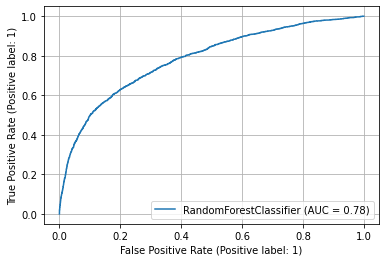

------------------------------


C:\Users\Egor\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


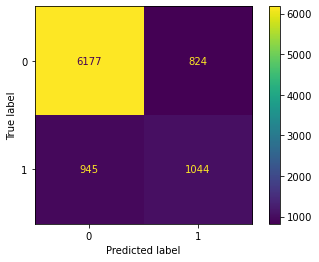

------------------------------
Accuracy для тестовой выборки: 0.8032258064516129
----------------------------------------------------------------------------------------------------
Balanced accuracy для тестовой выборки: 0.7035947030191549
----------------------------------------------------------------------------------------------------
F1-score для тестовой выборки: 0.5413533834586466
----------------------------------------------------------------------------------------------------
Precision score для тестовой выборки: 0.5588865096359743
----------------------------------------------------------------------------------------------------
Recall score для тестовой выборки: 0.5248868778280543
----------------------------------------------------------------------------------------------------
F-beta score для тестовой выборки: 0.5413533834586466
----------------------------------------------------------------------------------------------------
------------------------------
        

In [320]:
print(f'Значение F1 на тестовой выборке равна {f1_score(target_test,upsample_predict)}')
print('-'*30)

# рисуем ROC кривую
plot_roc_curve(upsample_best_model,features_test,target_test)
plt.grid()
plt.show()
print('-'*30)

plot_confusion_matrix(upsample_best_model,features_test,target_test)
plt.show()
print('-'*30)

metrics_check(target_test,upsample_predict)

print('-'*30)
print(classification_report(target_test,upsample_predict))

## Downsampling

In [260]:
# функция для сокращения количество доминирующего класса
def downsample(features, target, fraction):
    np.random.seed(7)
    features_zeros = features[target == 0]
    features_ones = features[target == 1]
    target_zeros = target[target == 0]
    target_ones = target[target == 1]

    features_downsampled = pd.concat(
        [features_zeros.sample(frac=fraction)] + [features_ones])
    target_downsampled = pd.concat(
        [target_zeros.sample(frac=fraction)] + [target_ones])
    
    features_downsampled, target_downsampled = shuffle(
        features_downsampled, target_downsampled, random_state=12345)
    
    return features_downsampled, target_downsampled




In [261]:
features_downsample, target_downsample = downsample(features_train, target_train, 0.3)


In [262]:
target_downsample.value_counts()

0    4900
1    4641
Name: default_payment_next_month, dtype: int64

In [263]:
#  с помощью библиотеки optuna 
#  подберем лучшие гиперпараметры
# максимизируя F1-score
def objective(trial):
    clf_name = trial.suggest_categorical('classifier',['RandomForest'])
    if clf_name == 'RandomForest':
        max_depth = trial.suggest_int('max_depth',5,15)
        n_estimators = trial.suggest_int('n_estimators',5,150)
        criterion = trial.suggest_categorical('criterion',['gini','entropy'])
        clf_obj = RandomForestClassifier(criterion=criterion,
                                         max_depth=max_depth,
                                         n_estimators=n_estimators,
                                         class_weight=train_class_weights,
                                         random_state=rs)
    # Определяем метрику, на основе которой будет производиться оценка качества
    scorer = make_scorer(roc_auc_score)
    clf_obj.fit(features_downsample,target_downsample)
    # Выполняем кросс-валидацию
    scores = cross_val_score(clf_obj, features_downsample, target_downsample, cv=3, scoring=scorer)
    # Вычисляем среднее значение F-меры по всем фолдам
    mean_score = scores.mean()
    return mean_score

In [264]:
np.random.seed(7)
if __name__ == '__main__':
    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials =25)
    print(study.best_trial)

[I 2023-05-07 20:16:07,365] A new study created in memory with name: no-name-8849e52f-2088-4b60-90dd-a003686c53b2
[I 2023-05-07 20:16:14,499] Trial 0 finished with value: 0.639415801290347 and parameters: {'classifier': 'RandomForest', 'max_depth': 13, 'n_estimators': 105, 'criterion': 'entropy'}. Best is trial 0 with value: 0.639415801290347.
[I 2023-05-07 20:16:17,416] Trial 1 finished with value: 0.5146824652875978 and parameters: {'classifier': 'RandomForest', 'max_depth': 5, 'n_estimators': 88, 'criterion': 'entropy'}. Best is trial 0 with value: 0.639415801290347.
[I 2023-05-07 20:16:19,618] Trial 2 finished with value: 0.5492601255585722 and parameters: {'classifier': 'RandomForest', 'max_depth': 7, 'n_estimators': 76, 'criterion': 'gini'}. Best is trial 0 with value: 0.639415801290347.
[I 2023-05-07 20:16:26,794] Trial 3 finished with value: 0.5827878636757048 and parameters: {'classifier': 'RandomForest', 'max_depth': 9, 'n_estimators': 94, 'criterion': 'entropy'}. Best is tri

FrozenTrial(number=6, values=[0.6730512813905737], datetime_start=datetime.datetime(2023, 5, 7, 20, 16, 42, 254479), datetime_complete=datetime.datetime(2023, 5, 7, 20, 16, 46, 885662), params={'classifier': 'RandomForest', 'max_depth': 15, 'n_estimators': 86, 'criterion': 'gini'}, distributions={'classifier': CategoricalDistribution(choices=('RandomForest',)), 'max_depth': IntDistribution(high=15, log=False, low=5, step=1), 'n_estimators': IntDistribution(high=150, log=False, low=5, step=1), 'criterion': CategoricalDistribution(choices=('gini', 'entropy'))}, user_attrs={}, system_attrs={}, intermediate_values={}, trial_id=6, state=TrialState.COMPLETE, value=None)


In [265]:


# определение параметров для подбора
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['liblinear']}

# создание экземпляра логистической регрессии
lr = LogisticRegression()

# создание экземпляра GridSearchCV и запуск поиска по сетке
grid_search = GridSearchCV(estimator=lr, param_grid=param_grid, cv=3, scoring='roc_auc')
grid_search.fit(features_downsample, target_downsample)

# вывод лучших параметров и метрик на обучающей и тестовой выборке
print('Лучшие параметры:', grid_search.best_params_)
print('ROC-AUC-score на обучающей выборке:', grid_search.best_score_)


Лучшие параметры: {'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}
ROC-AUC-score на обучающей выборке: 0.7200900054219591


In [312]:
downsample_best_model = LogisticRegression(C=1,penalty='l1',solver='liblinear')

In [313]:
downsample_best_model.fit(features_downsample,target_downsample)

LogisticRegression(C=1, penalty='l1', solver='liblinear')

In [314]:
downsample_predict = downsample_best_model.predict(features_test)

Значение F1 на тестовой выборке равна 0.492929292929293
------------------------------


C:\Users\Egor\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metrics.RocCurveDisplay.from_predictions` or :meth:`sklearn.metrics.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


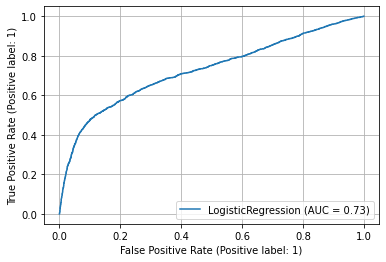

------------------------------


C:\Users\Egor\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


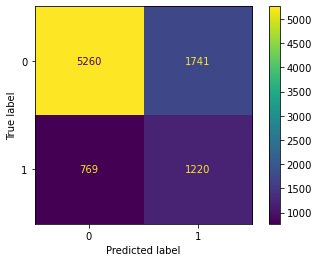

------------------------------
Accuracy для валидационной выборки: 0.7208008898776418
----------------------------------------------------------------------------------------------------
Balanced accuracy для валидационной выборки: 0.6823473971864538
----------------------------------------------------------------------------------------------------
F1-score для валидационной выборки: 0.492929292929293
----------------------------------------------------------------------------------------------------
Precision score для валидационной выборки: 0.4120229652144546
----------------------------------------------------------------------------------------------------
Recall score для валидационной выборки: 0.6133735545500252
----------------------------------------------------------------------------------------------------
F-beta score для валидационной выборки: 0.492929292929293
----------------------------------------------------------------------------------------------------
-----------

In [315]:
print(f'Значение F1 на тестовой выборке равна {f1_score(target_test,downsample_predict)}')
print('-'*30)

# рисуем ROC кривую
plot_roc_curve(downsample_best_model,features_test,target_test)
plt.grid()
plt.show()
print('-'*30)

plot_confusion_matrix(downsample_best_model,features_test,target_test)
plt.show()
print('-'*30)

metrics_check(target_test,downsample_predict)

print('-'*30)
print(classification_report(target_test,downsample_predict))

## Итоговый вывод

**Вывод:**

Лучшая модель - **RandomForestClassifier**, с гиперпараметрами:

* **max_depth=15**
* **n_estimators=148**
* **criterion='gini'**
------
Техники избавления от дисбаланса классов:

* **Upsampling**
* **Stratify**
--------
**Метрики на тестовой выборки:**

* **Accuracy** для тестовой выборки: **0.8032258064516129**

* **Balanced accuracy** для тестовой выборки: **0.7035947030191549**

* **F1-score** для тестовой выборки: **0.5413533834586466**

* **Precision score** для тестовой выборки: **0.5588865096359743**

* **Recall score** для тестовой выборки: **0.5248868778280543**

* **F-beta score** для тестовой выборки: **0.5413533834586466**
---------------
Отчет прогнозов по классам

**0:**
* **precision** - **0.87**
* **recall** - **0.88**
* **score** - **0.87**

**1:**

* **precision** - **0.56 **
* **recall** - **0.52**
* **score** - **0.54 **


Метрики можно улучшить, попробовав другие модели CNN, бустинги, а также другие алгоритмы.

Вдобавок, для лучших результатов стоит выявить шум и аномалии в данных более тщательно.
